In [167]:
import numpy as np
import pandas as pd
#from hetdex_api.amp_widget import AmpWidget
from hetdex_api.shot import get_image2D_amp
import matplotlib.pyplot as plt
%matplotlib inline
from astropy.visualization import ZScaleInterval

In [168]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [169]:
allpredictions = np.load('saved_predictions/predictions_hdr3.npy', allow_pickle=True)
preds_df = pd.DataFrame(allpredictions[1:], columns=allpredictions[0])

In [170]:
preds_df.columns
print(preds_df.head())

        shotid expnum            multiframe   norm N_cont background  \
0  20170103002      1  multi_004_106_033_LL  0.964    0.0       0.07   
1  20170103002      2  multi_004_106_033_LL  0.964    0.0       0.11   
2  20170103002      3  multi_004_106_033_LL   0.98    0.0       0.09   
3  20170103002      1  multi_004_106_033_LU  0.972    0.0       0.13   
4  20170103002      2  multi_004_106_033_LU  0.976    1.0       0.07   

  sky_sub_rms wave0 wave1 nfib_bad  ...  im_median MaskFraction flag_manual  \
0       13.92  0.08   0.0      0.0  ...  12.712891     0.083204           1   
1       14.53  0.08 -0.08      0.0  ...  14.871094     0.082461           1   
2       15.06   0.0 -0.08      0.0  ...  16.751953      0.08248           1   
3       14.72   0.0  0.16      0.0  ...  13.158203     0.090775           1   
4       15.35   0.0  0.24      0.0  ...  15.359375     0.090446           1   

  flag cut_flag manual_prob  net_prob cut_prob notauto_prob  \
0  1.0        1    0.920987  

In [171]:
newflag, oldflag = 'notauto_hyperopt_prob', 'notauto_prob'
#inds = np.where((preds_df[newflag] > 0.5 ) & (preds_df[oldflag] < 0.5) & (preds_df['cut_flag'] == 1))[0]
inds = np.where((preds_df[newflag] > 0.9) & (preds_df[newflag] <0.95 ) & (preds_df['flag'] ==1))
#inds = np.where( (preds_df[newflag] < 0.95))

In [172]:
looparr = preds_df[['shotid','expnum','multiframe','cut_flag','notauto_prob', 'notauto_hyperopt_prob']]
looparr=looparr.iloc[inds]
looparr.head()


,shotid,expnum,multiframe,cut_flag,notauto_prob,notauto_hyperopt_prob
156,20170103002,1,multi_051_105_051_LL,1,1.0,0.948107
324,20170103003,1,multi_051_105_051_LL,1,1.0,0.911271
540,20170105009,1,multi_016_104_026_LL,1,1.0,0.933556
541,20170105009,2,multi_016_104_026_LL,1,1.0,0.942891
877,20170105011,2,multi_016_104_026_LL,1,0.991975,0.920991


In [173]:
print(looparr.shape[0], 'bad amps')
print(np.round(looparr.shape[0] / preds_df.shape[0]* 100, 4), '% bad')

2552 bad amps
0.0927 % bad


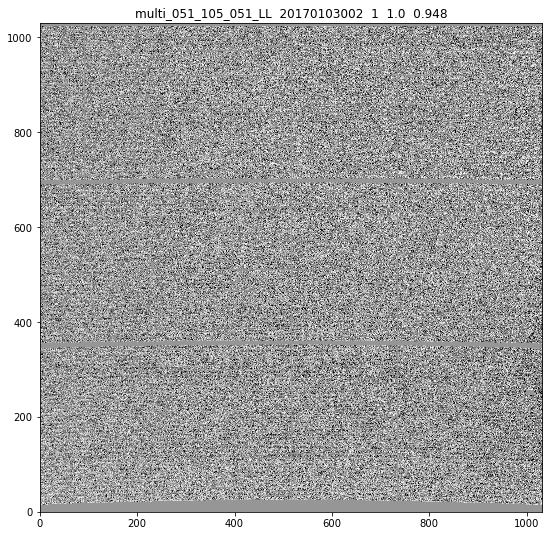

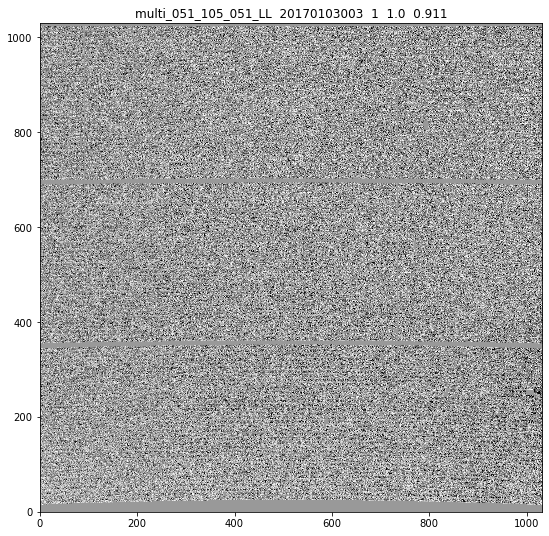

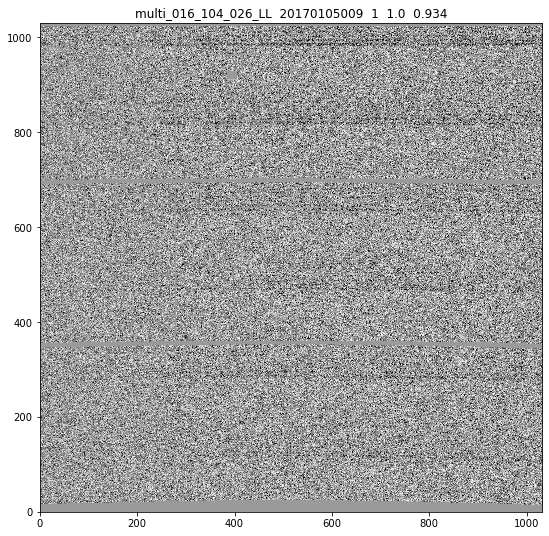

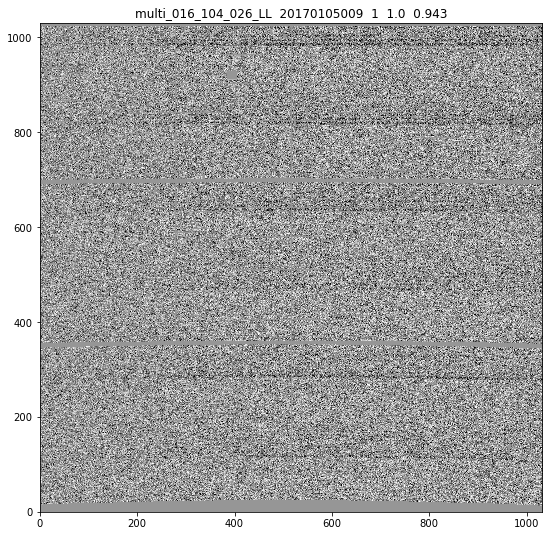

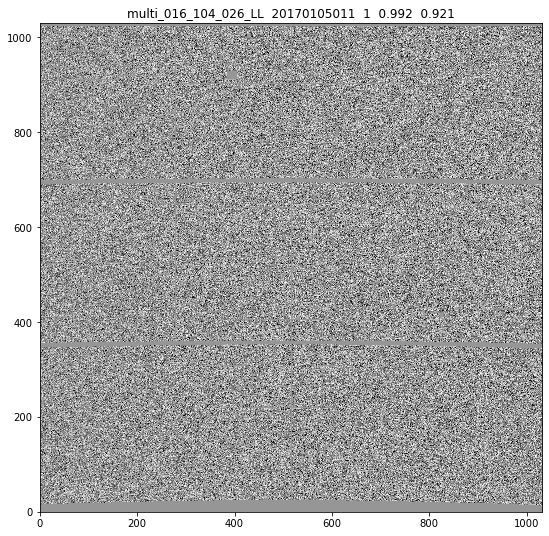

...

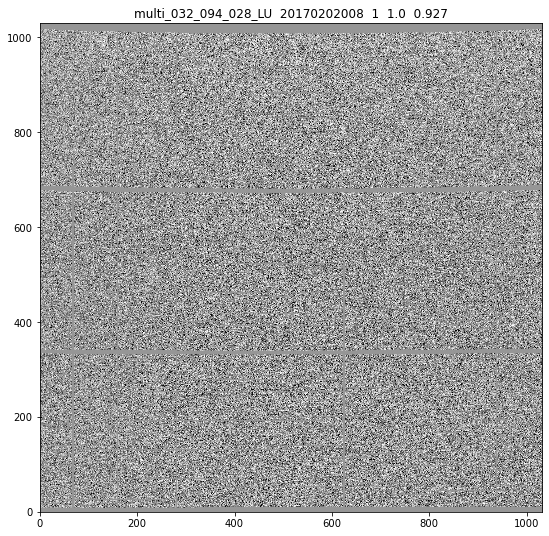

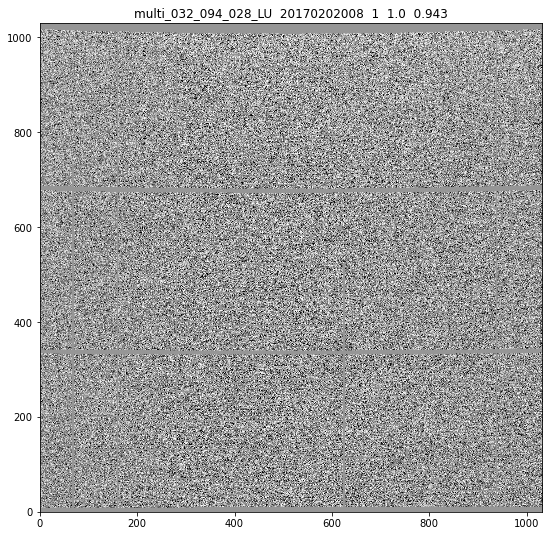

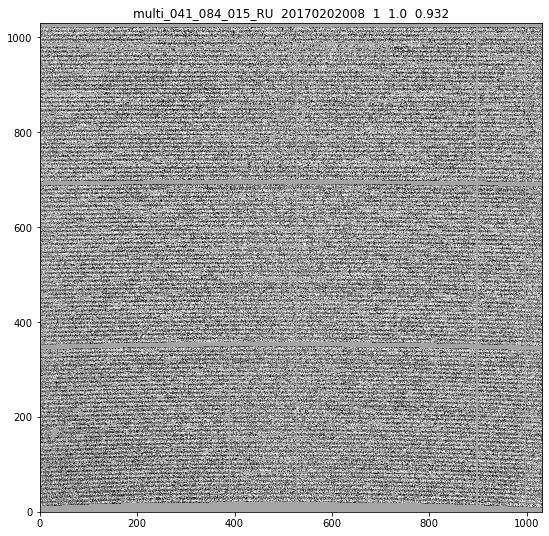

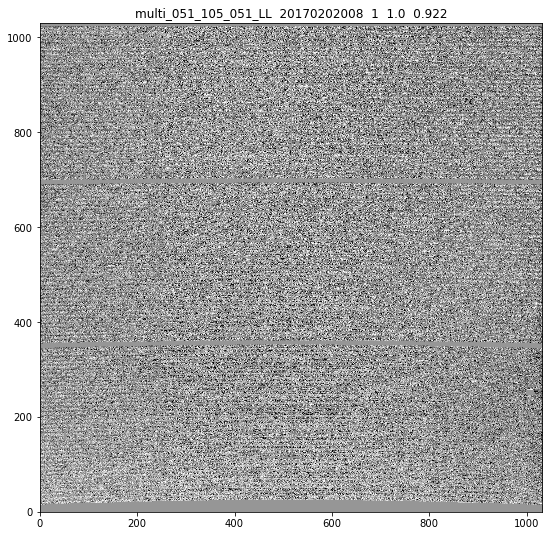

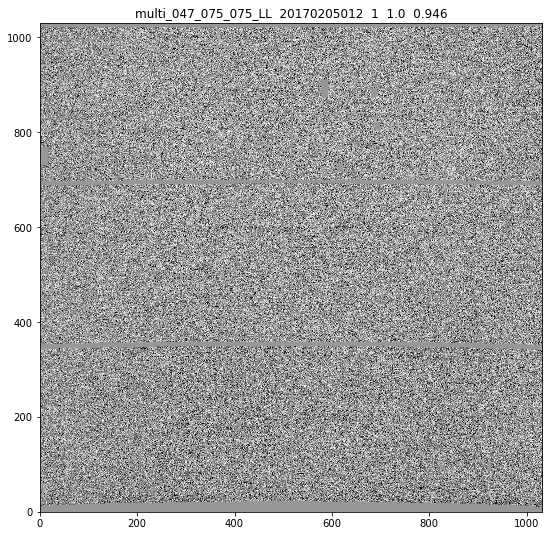

In [174]:
for (si, expnum, mf, cut, probold, probnew) in looparr[:50].values:
            im = get_image2D_amp(int(si), multiframe=mf, imtype='clean_image', 
                         survey='hdr3', expnum=int(expnum))
            zscale = ZScaleInterval(contrast=0.5, krej=2.5)
            vmin,vmax = zscale.get_limits(values=im)
            plt.figure(figsize=(9,9))
            plt.imshow(im, vmin=vmin, vmax=vmax, origin='lower', cmap='Greys', aspect='auto', interpolation='none')
            plt.title(mf + '  '+ str(si)+'  '+str(cut)+'  '+str(np.round(probold, 3))+'  '+str(np.round(probnew,3)))

In [175]:
hopt_prob = preds_df['notauto_hyperopt_prob']
mask = preds_df['flag'].astype('bool')

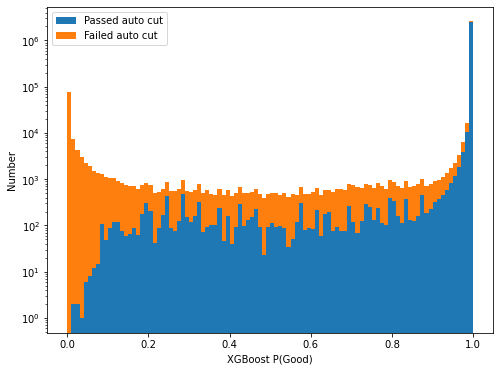

In [176]:
plt.figure(figsize=(8,6))
plt.hist((hopt_prob[mask], hopt_prob[~mask]),stacked=True,bins=100,label=('Passed auto cut', 'Failed auto cut'))
plt.yscale('log')
plt.legend()
plt.xlabel('XGBoost P(Good)')
plt.ylabel('Number')
plt.show()

In [8]:
hdr2predictions = np.load('saved_predictions/predictions_hdr2.npy', allow_pickle=True)
hdr2_df = pd.DataFrame(hdr2predictions[1:], columns=hdr2predictions[0])

In [9]:
hdr2_df.columns

Index(['shotid', 'expnum', 'multiframe', 'flag_manual', 'flag', 'ft_flag',
       'flag_badamp', 'flag_auto', 'flag_badamp_not_auto', 'manual_flag_prob',
       'net_flag_prob', 'cut_flag_prob', 'notauto_flag_prob'],
      dtype='object')

In [12]:
notauto = hdr2_df.notauto_flag_prob < 0.5

In [14]:
np.sum(notauto)

87131

In [22]:
print((len(preds_df) - len(hdr2_df))/len(hdr2_df))
print(len(hdr2_df))

0.47681193207606903
1857313


In [177]:
preds_df.columns

Index(['shotid', 'expnum', 'multiframe', 'norm', 'N_cont', 'background',
       'sky_sub_rms', 'wave0', 'wave1', 'nfib_bad', 'median_sky_rms',
       'stdev_sky_rms', 'sky_sub_rms_rel', 'im_median', 'MaskFraction',
       'flag_manual', 'flag', 'cut_flag', 'manual_prob', 'net_prob',
       'cut_prob', 'notauto_prob', 'notauto_hyperopt_prob'],
      dtype='object')

In [181]:
shotid = 20180810009
mf = 'multi_303_025_013_LU'
expnum = 1

In [184]:
smask = preds_df.shotid==shotid
mfmask = preds_df.multiframe==mf
emask = preds_df.expnum==expnum

In [187]:
weirdo = preds_df[smask & mfmask & emask]


In [190]:
for column in preds_df.columns:
    print(column, weirdo[column].values)

shotid [20180810009]
expnum [1]
multiframe ['multi_303_025_013_LU']
norm [1.0]
N_cont [43.0]
background [13.06]
sky_sub_rms [37.82]
wave0 [0.42]
wave1 [0.0]
nfib_bad [5.0]
median_sky_rms [16.94]
stdev_sky_rms [2.285519907323464]
sky_sub_rms_rel [2.2325855962219596]
im_median [25.85546875]
MaskFraction [0.07091483384411995]
flag_manual [1]
flag [0.0]
cut_flag [0]
manual_prob [0.9976677298545837]
net_prob [6.24411140197692e-14]
cut_prob [1.6072723596494143e-08]
notauto_prob [0.27367904782295227]
notauto_hyperopt_prob [0.013708779588341713]
